In [1]:
from diffusers import StableDiffusionPipeline
import torch

model_id = "xyn-ai/anything-v4.0"
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16, requires_safety_checker=False)
pipe = pipe.to("cuda")
pipe.enable_xformers_memory_efficient_attention()
pipe.safety_checker = None

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
/home/kiddos/.local/lib/python3.8/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


In [2]:
print(pipe)

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.18.1",
  "feature_extractor": [
    "transformers",
    "CLIPFeatureExtractor"
  ],
  "requires_safety_checker": false,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}



In [3]:
print(pipe.scheduler)

PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.18.1",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "timestep_spacing": "leading",
  "trained_betas": null
}



  0%|          | 0/50 [00:00<?, ?it/s]

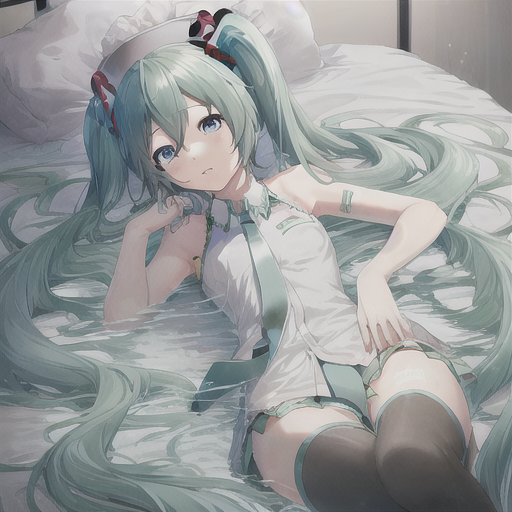

In [4]:
prompt = "hatsune_miku"
pipe(prompt).images[0]

Token indices sequence length is longer than the specified maximum sequence length for this model (152 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['mucha ), ( inspired by : luna lovegood, evanna lynch, jenna ortega, jade cocoon, toph avatar, raven teen titans, nausicaa, etrian odyssey, made in abyss, pathfinder ), detailed, absurdres, dark forest background, beech and birch trees, flowers, depth of field, high resolution, bokeh, cute, dawn, dusk']


  0%|          | 0/50 [00:00<?, ?it/s]

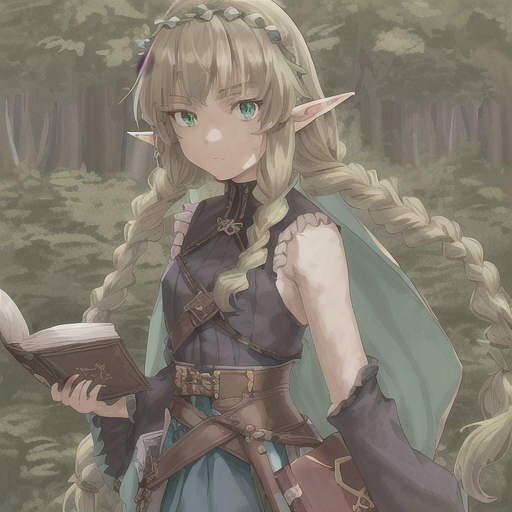

In [5]:
prompt = "medium full shot, female focus, symmetric face, fourteen year old, short druid elf girl, dark dirty blonde hair, big braids, flower crown in hair, loose sleeveless top, asymmetric dark blue and green clothes, skirt, belt, corset, short cape, satchel, book, (by: LasterK, norasuko, Joel Jurion, Alphonse Mucha), (inspired by: Luna Lovegood, Evanna Lynch, Jenna Ortega, Jade Cocoon, Toph Avatar, Raven Teen Titans, Nausicaa, Etrian Odyssey, Made in Abyss, Pathfinder), detailed, absurdres, dark forest background, beech and birch trees, flowers, depth of field, high resolution, bokeh, cute, dawn, dusk"
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

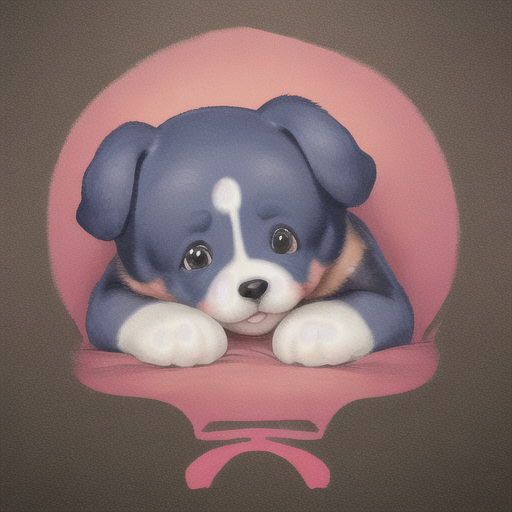

In [6]:
prompt = "puppy"
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

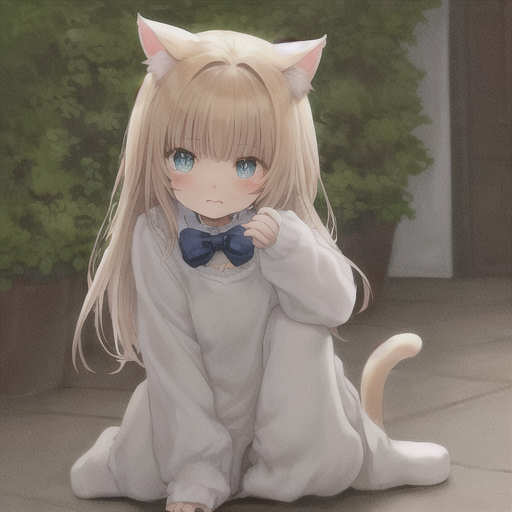

In [7]:
prompt = "cute cat"

pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

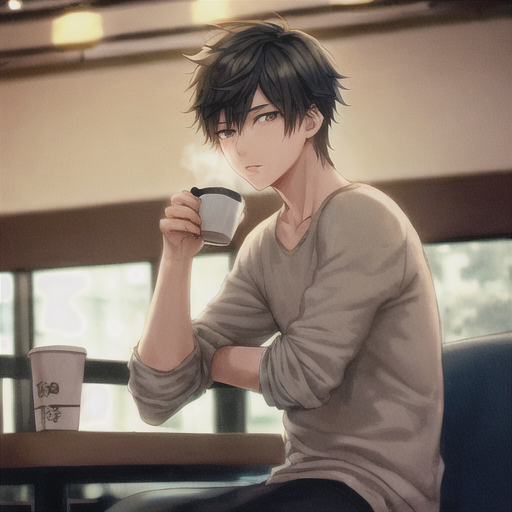

In [8]:
prompt = "1boy, bishounen, casual, indoors, sitting, coffee shop, bokeh"
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

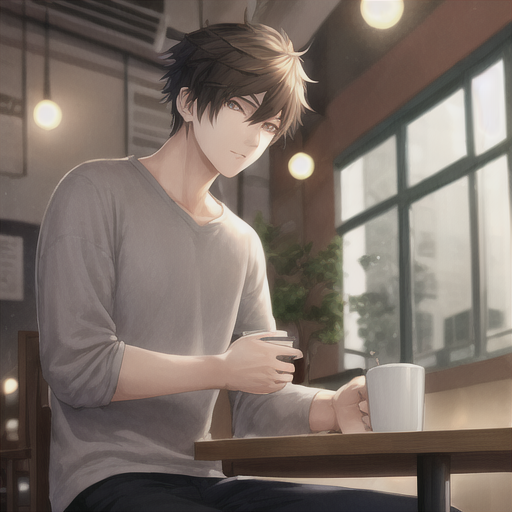

In [9]:
prompt = "1boy, bishounen, casual, indoors, sitting, coffee shop, bokeh"
pipe(prompt).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

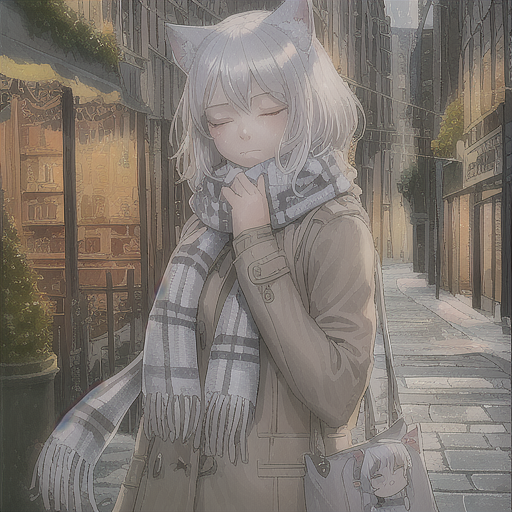

In [10]:
# Steps: 20, Sampler: DPM++ 2M Karras, CFG scale: 7
from diffusers import DDPMScheduler

pipe.scheduler = DDPMScheduler(
  num_train_timesteps=1000,
)

prompt = 'masterpiece, best quality, 1girl, white hair, medium hair, cat ears, closed eyes, looking at viewer, :3, cute, scarf, jacket, outdoors, streets'
pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=7.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

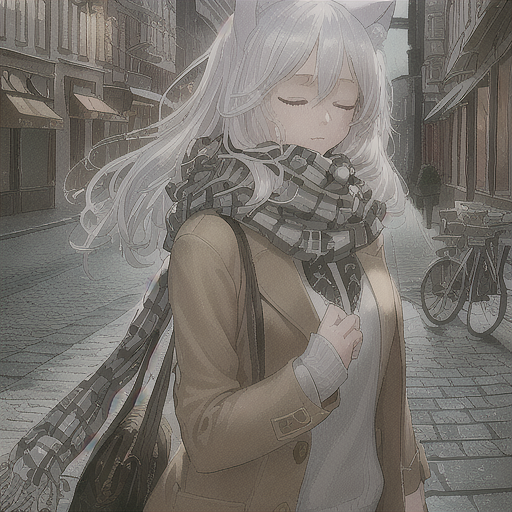

In [11]:
pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=9.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

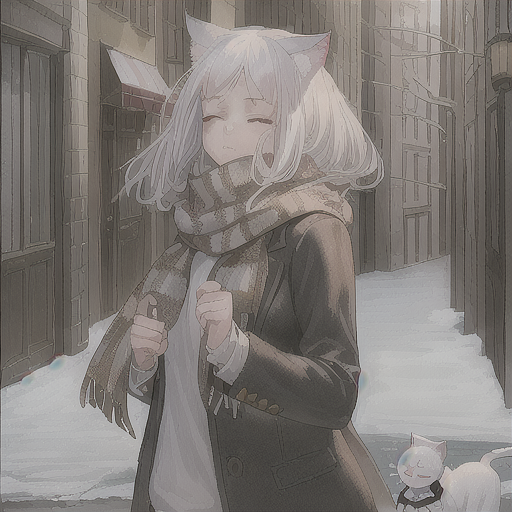

In [12]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=1500,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=9.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

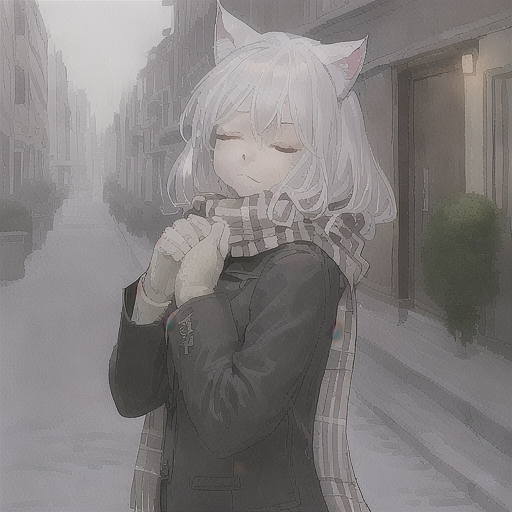

In [13]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=3000,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=9.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

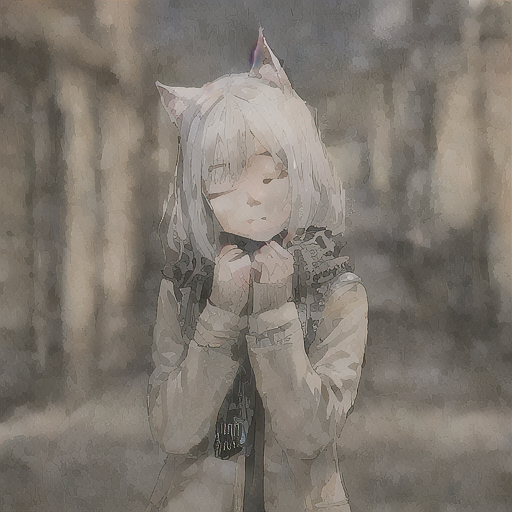

In [14]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=10000,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=9.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

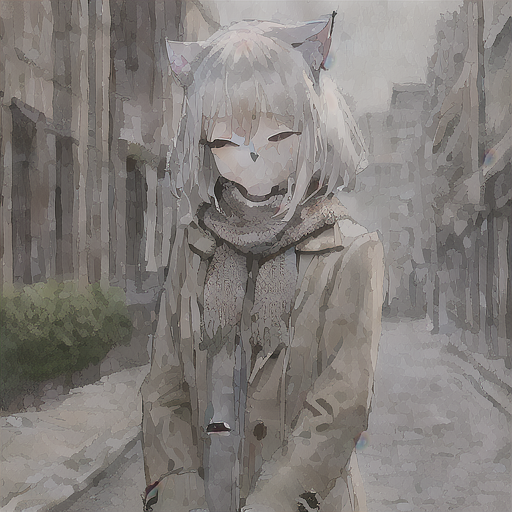

In [15]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=10000,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=20.0
).images[0]

  0%|          | 0/100 [00:00<?, ?it/s]

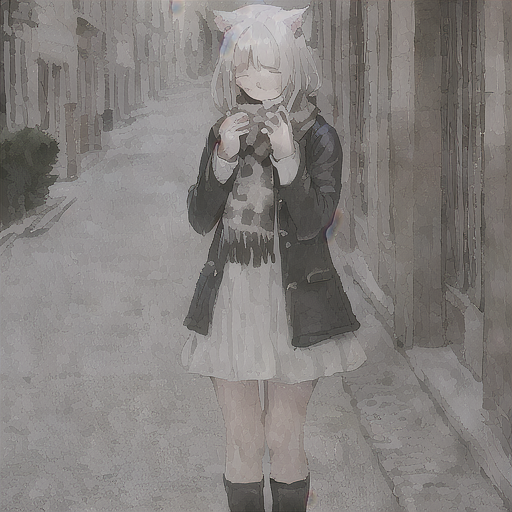

In [16]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=10000,
)

pipe(
  prompt,
  num_inference_steps=100,
  guidance_scale=15.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

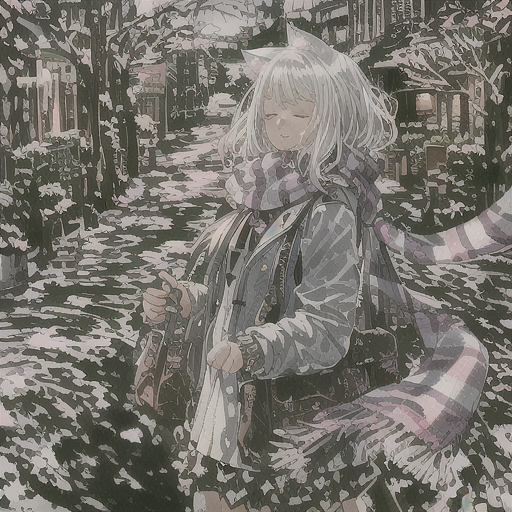

In [17]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=600,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=6.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

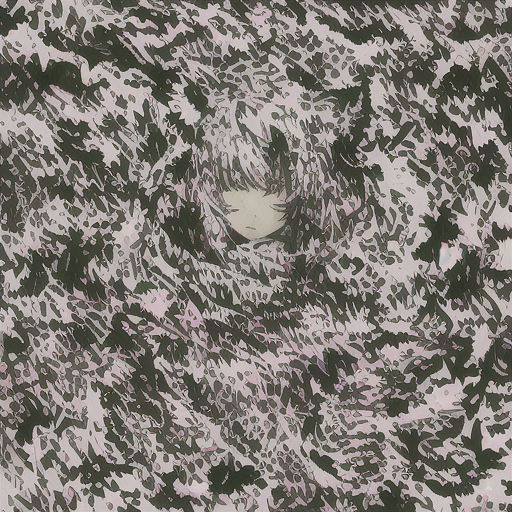

In [18]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=600,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=3.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

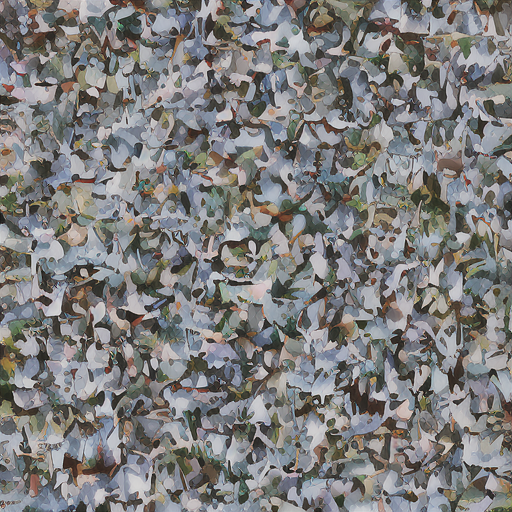

In [19]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=100,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=3.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

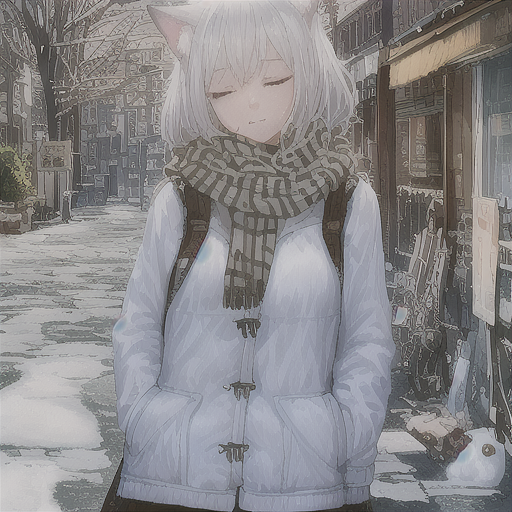

In [20]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=1000,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=3.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

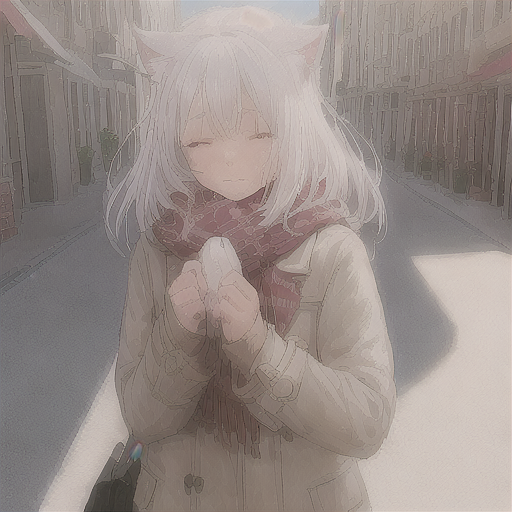

In [21]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=2000,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=3.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

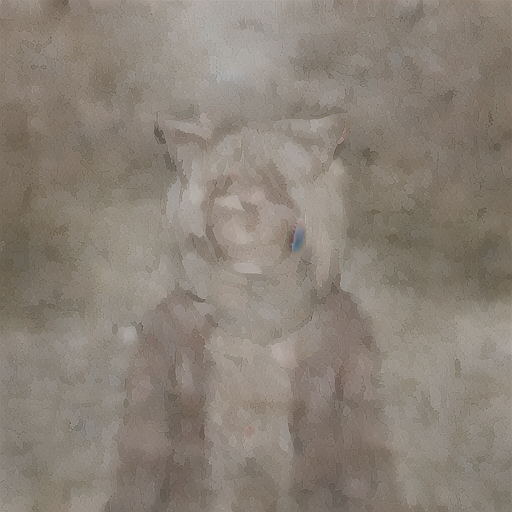

In [22]:
pipe.scheduler = DDPMScheduler(
  num_train_timesteps=10000,
)

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=3.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

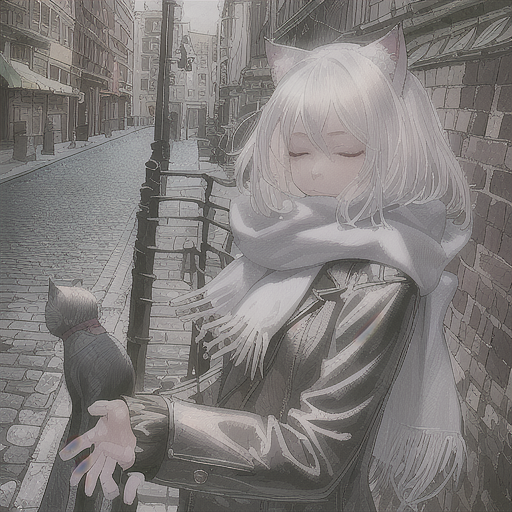

In [23]:
pipe.scheduler = DDPMScheduler()

pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=6.6
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

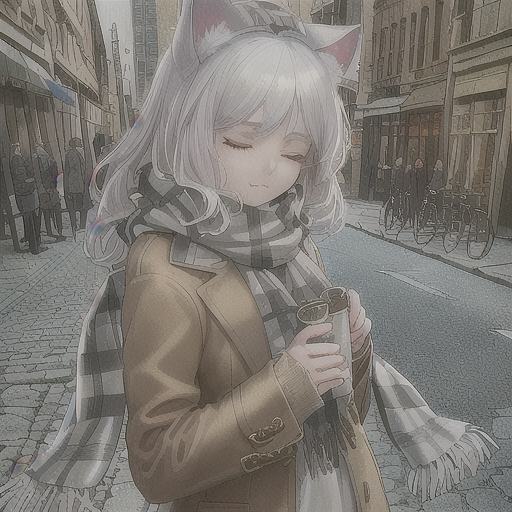

In [24]:
pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=9.6
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

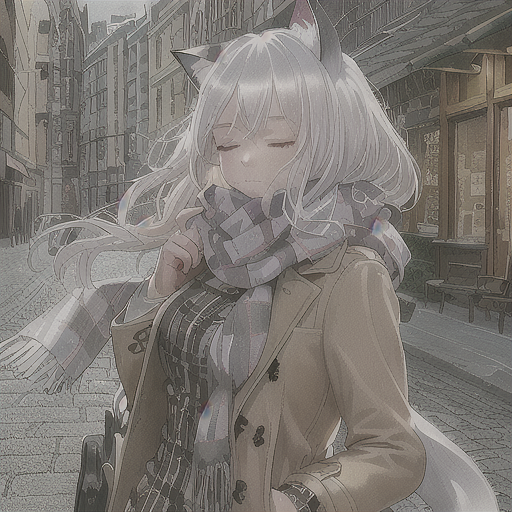

In [25]:
pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=12.0
).images[0]

  0%|          | 0/60 [00:00<?, ?it/s]

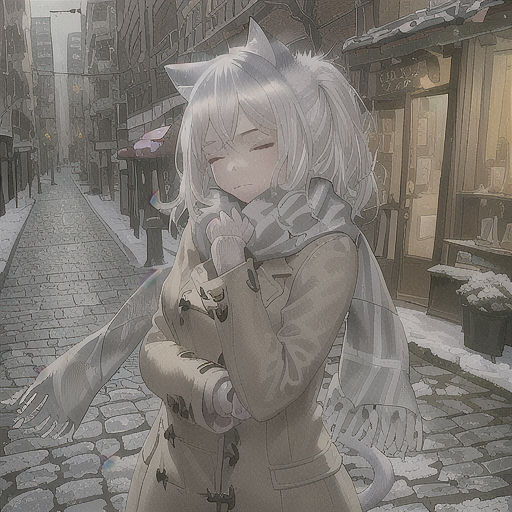

In [26]:
pipe(
  prompt,
  num_inference_steps=60,
  guidance_scale=16.0
).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

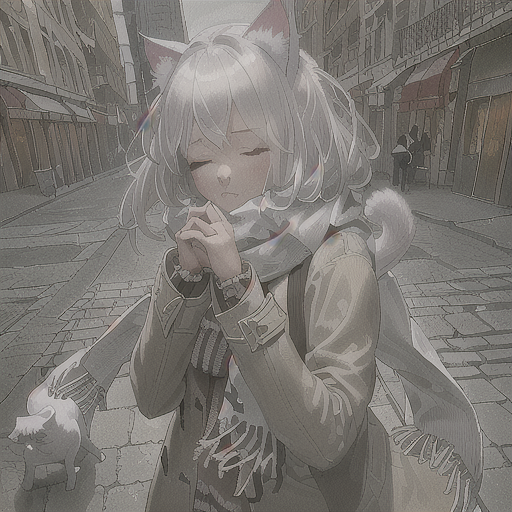

In [27]:
pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=20.0
).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

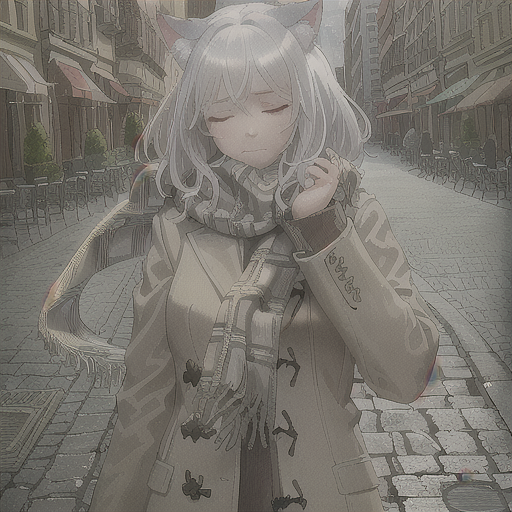

In [28]:
pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=15.0
).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

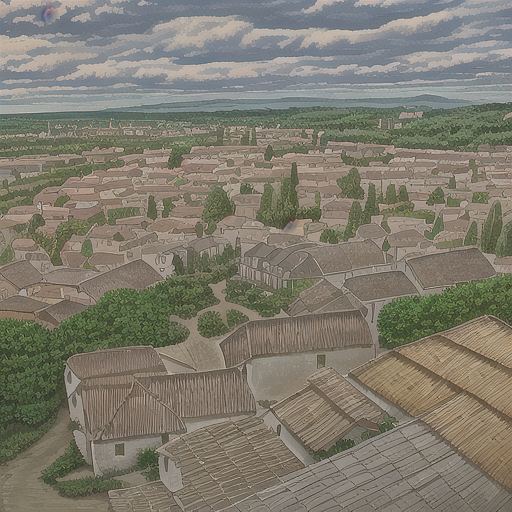

In [29]:
prompt = 'scenery, village, outdoors, sky, clouds'

pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=15.0
).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

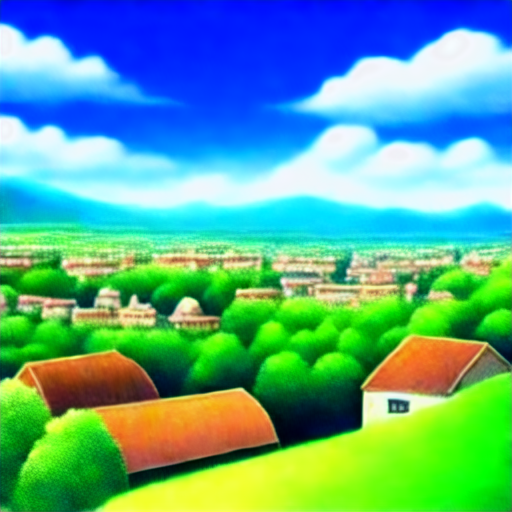

In [30]:
from diffusers import PNDMScheduler

pipe.scheduler = PNDMScheduler()

pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=15.0
).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

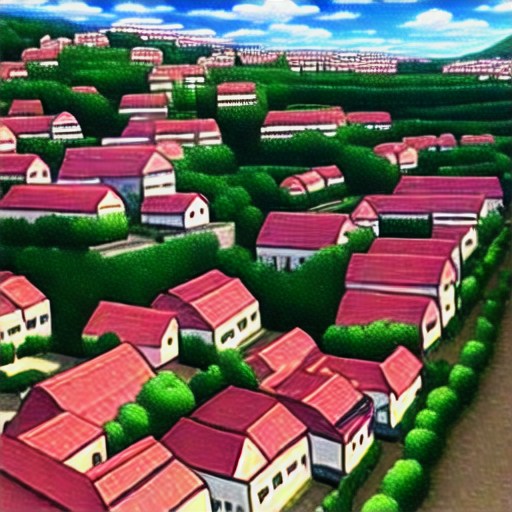

In [31]:
pipe.scheduler = PNDMScheduler(
  num_train_timesteps=700,
)

pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=15.0
).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

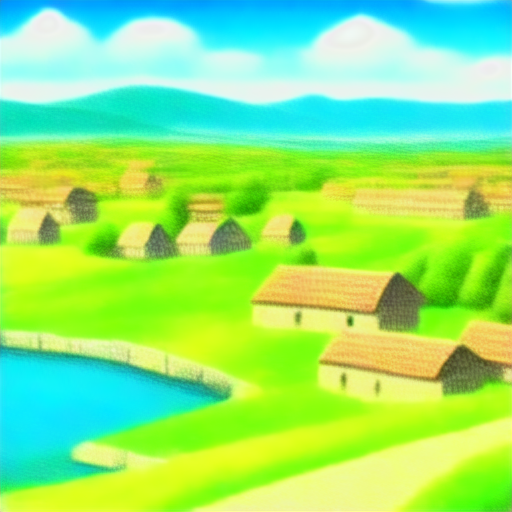

In [32]:
pipe.scheduler = PNDMScheduler(
  num_train_timesteps=1000,
)

pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=7.6
).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

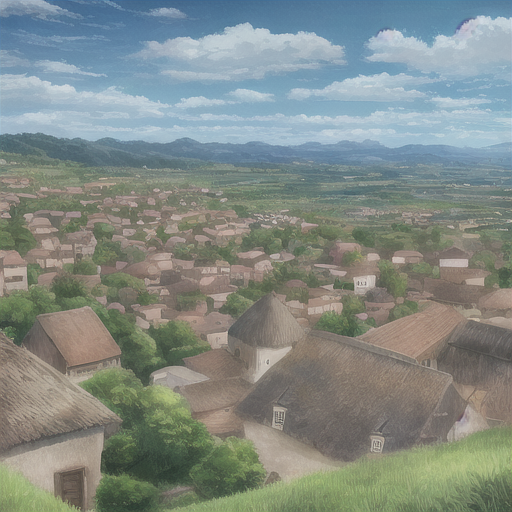

In [34]:
default_scheduler_args = {
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": False,
  "skip_prk_steps": True,
  "steps_offset": 1,
  "timestep_spacing": "leading",
  "trained_betas": None
}

pipe.scheduler = PNDMScheduler(**default_scheduler_args)
pipe(prompt).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

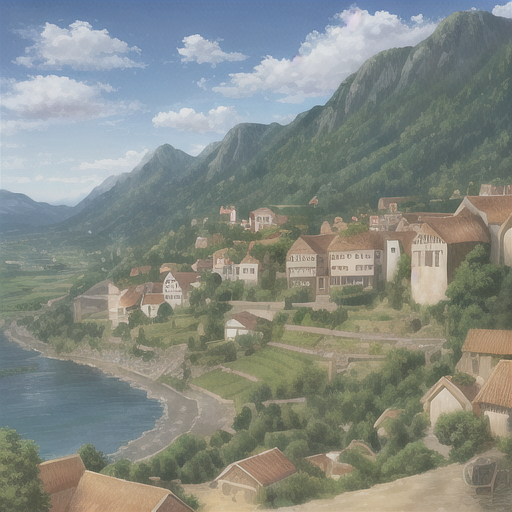

In [35]:
pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=9.6
).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

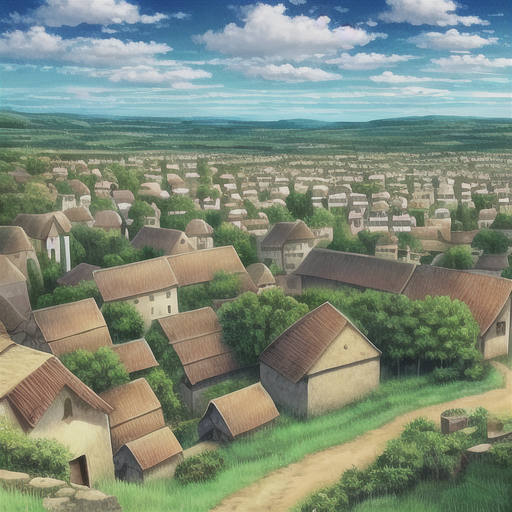

In [36]:
pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=16.0
).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

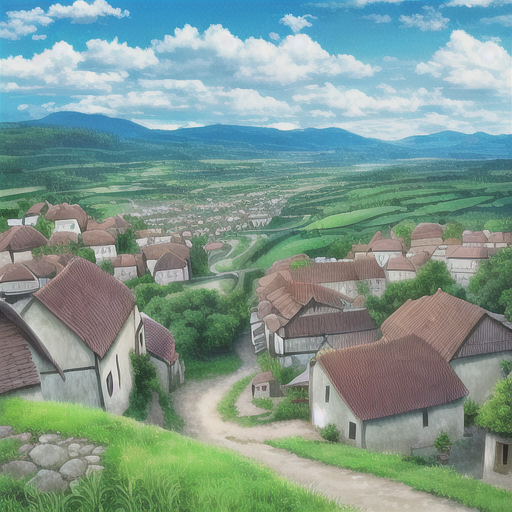

In [37]:
pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=20.0
).images[0]

  0%|          | 0/66 [00:00<?, ?it/s]

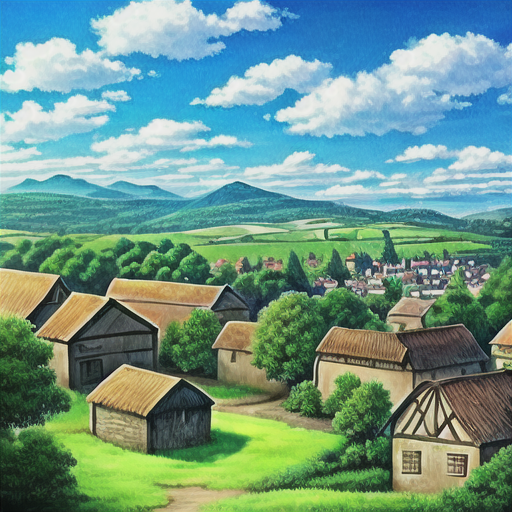

In [38]:
pipe(
  prompt,
  num_inference_steps=66,
  guidance_scale=30.0
).images[0]